# Emerging Technology Project
# Power Production

The goal of this project is to produce a model that accurately predicts wind turbine power output from wind speed values in a data set. 


### So what is a wind turbine
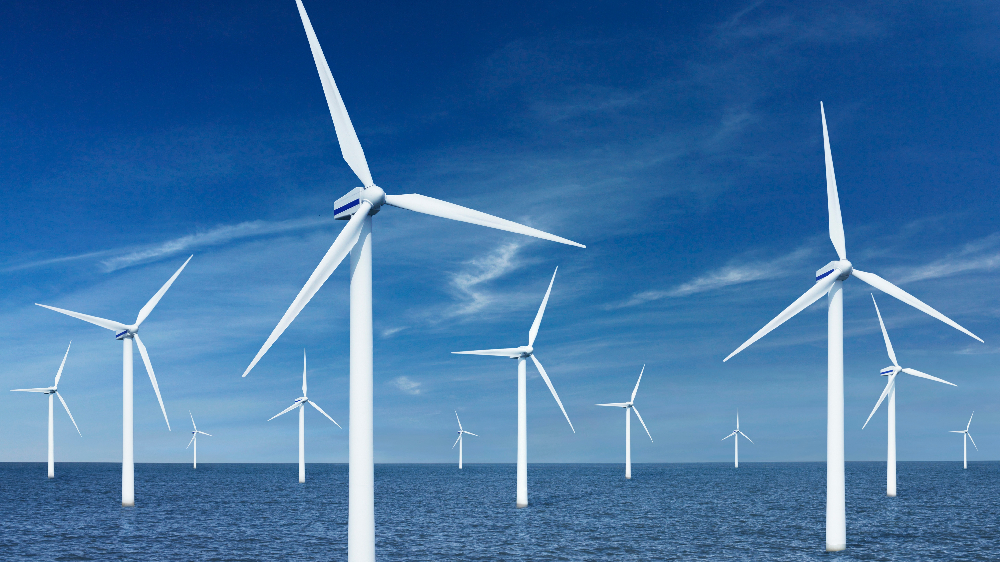
A wind turbine is a device, usually 100 to 300 feet in height, that converts kinetic wind energy into electric energy. As the wind blows past the blades, which work like an airplane wing or helicopter rotor blade, it causes the blades to spin. The blades are are connected to a rotor, that in turn is connected to a generator. this aerodynamic force causes the generator to create electricity.

### So what is a keras
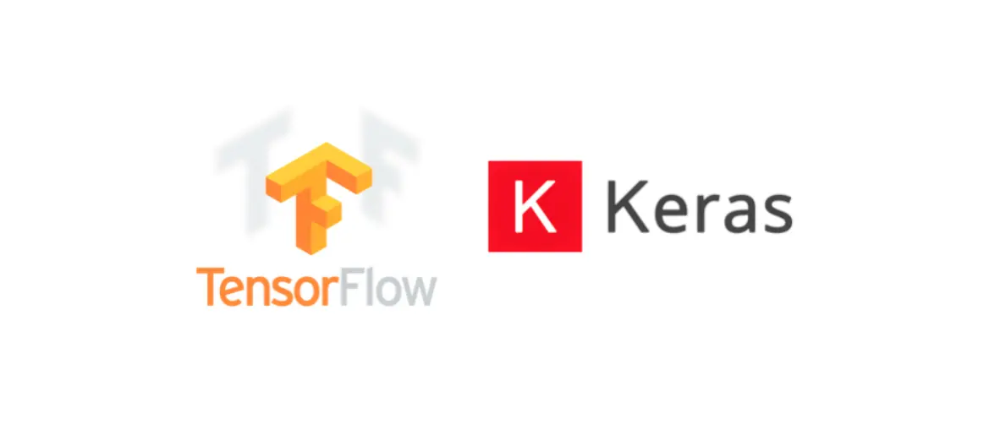
Keras is an open source library that provides python an interface for the tensorflow library. It was developed with a focus on enabling fast experimentation. We use these for machine learning, to accurately predict the outcome of a power value based on the speed value.

These are the imported libraries for the project.

In [1]:
# Numerical arrays
import numpy as np
# data Frames
import pandas as panda
# Plotting
import matplotlib.pyplot as plt
import tensorflow as tensor
# Neural networks.
import tensorflow.keras as kr
from sklearn.model_selection import train_test_split
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import SGD,Adam

Here I read in the dataset from a URL given to us from our lecturer. This saves it to a CSV file to be precoessed. I then print the first 20 members of the dataset to prove that data has been read.

In [2]:
#Reads in the dataset as CSV from url
myPPData = panda.read_csv("https://raw.githubusercontent.com/ianmcloughlin/2020A-machstat-project/master/dataset/powerproduction.csv")
#Prints first 20 members of dataset
myPPData.head(20)

,speed,power
0,0.000,0.000
1,0.125,0.000
2,0.150,0.000
3,0.225,0.000
4,0.275,0.000
5,0.325,4.331
6,0.400,5.186
7,0.450,3.826
8,0.501,1.048
9,0.526,5.553


I use a .describe function here to how the count, mean, min, max etc. This is to get a rough idea of how the data should be represented when plotted.

In [3]:
#prints data
myPPData.describe()

,speed,power
count,500.000000,500.000000
mean,12.590398,48.014584
std,7.224991,41.614572
min,0.000000,0.000000
25%,6.324750,5.288000
50%,12.550500,41.645500
75%,18.775250,93.537000
max,25.000000,113.556000


After this I plot the actual data from the dataset to confirm it has taken in the information correctly. You can see what the dataset looks like below.

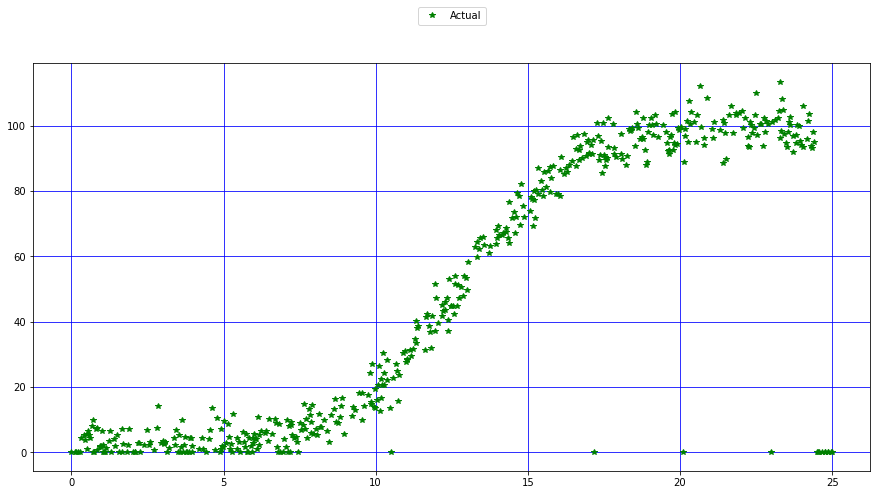

In [4]:
#changes the graphs size
plt.figure(figsize=(15,7.5))
#adds a grid to the graph
plt.grid(color='b', linestyle='-')
#plots the data given in the parameters
plt.plot(myPPData['speed'],myPPData['power'], 'g*', label='Actual')
#plots a legend outside the graph in the middle
plt.legend(loc="upper center", bbox_to_anchor=(0.5, 1.15), ncol=2)
#displays a figure
plt.show()

As you can see, the graph follows the sigmoid function. This means that our prediction must follow a similar design to this.
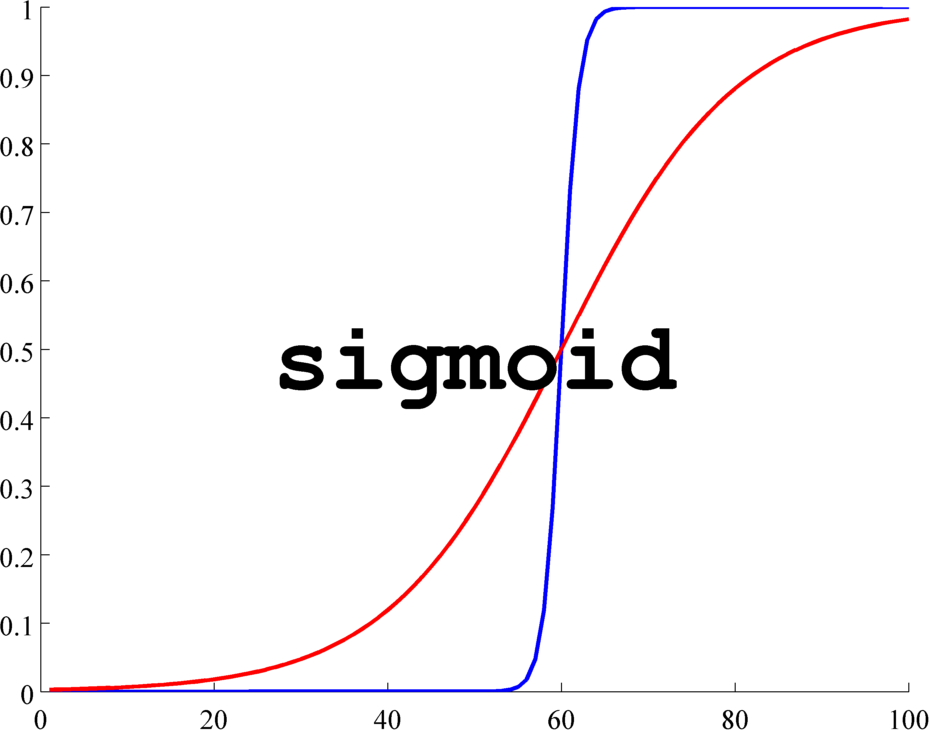


Here is where I begin the machine learning. I firstly save the first column of data frame and the second column of the dataset into variables(s & p) for reusability. After this I use the input function. Input() is used to instantiate a Keras tensor. After this I make 10 layers. As the graph itself is a sigmoid graph, i use an activation on "sigmoid" for these layers. I give the first layer a Dense nhumer of neurons 20, and all others 80 neurons. These were achieved via trial and error for the most accurate output with the least amount of loss. I then link the dense to the last layer and assign it to outputs. The model then groups the layers into an object named "model". I then complile the model whihc configs the model with losses and metrics. I then train the model with the .fit function.

In [5]:
# first column of data frame 
s = myPPData.iloc[:,0]
# second column of data frame 
p = myPPData.iloc[:,1]


# Build a simple model
inputs = kr.Input(shape=(1,))

# Layers
x1 = layers.Dense(20, activation="sigmoid")(inputs)
#normal = kr.layers.LayerNormalization()
x2 = layers.Dense(80, activation="sigmoid")(x1)
x3 = layers.Dense(80, activation="sigmoid")(x2)
x4 = layers.Dense(80, activation="sigmoid")(x3)
x5 = layers.Dense(80, activation="sigmoid")(x4)
x6 = layers.Dense(80, activation="sigmoid")(x5)
x7 = layers.Dense(80, activation="sigmoid")(x6)
x8 = layers.Dense(80, activation="sigmoid")(x7)
x9 = layers.Dense(80, activation="sigmoid")(x8)
x10 = layers.Dense(80, activation="linear")(x9)

#Used for building the output of the model
outputs = Dense(1)(x10)
#giving model its inputs and outputs
model = kr.Model(inputs=inputs, outputs=outputs) 
# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error')
# Train the neural network on our training data.
model.fit(s.values, p.values, epochs=10000, batch_size = 500)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 4013.0942
Epoch 2/10000
1/1 [==============================] - 0s 9ms/step - loss: 3957.8323
Epoch 3/10000
1/1 [==============================] - 0s 12ms/step - loss: 3903.1997
Epoch 4/10000
1/1 [==============================] - 0s 8ms/step - loss: 3849.0703
Epoch 5/10000
1/1 [==============================] - 0s 9ms/step - loss: 3795.3069
Epoch 6/10000
1/1 [==============================] - 0s 16ms/step - loss: 3741.7834
Epoch 7/10000
1/1 [==============================] - 0s 16ms/step - loss: 3688.3865
Epoch 8/10000
1/1 [==============================] - 0s 20ms/step - loss: 3635.0002
Epoch 9/10000
1/1 [==============================] - 0s 10ms/step - loss: 3581.5061
Epoch 10/10000
1/1 [==============================] - 0s 12ms/step - loss: 3527.7891
Epoch 11/10000
1/1 [==============================] - 0s 9ms/step - loss: 3473.7473
Epoch 12/10000
1/1 [==============================] - 0s 15ms/step - loss: 3419.

1/1 [==============================] - 0s 11ms/step - loss: 1728.3068
Epoch 193/10000
1/1 [==============================] - 0s 10ms/step - loss: 1728.3063
Epoch 194/10000
1/1 [==============================] - 0s 9ms/step - loss: 1728.3066
Epoch 195/10000
1/1 [==============================] - 0s 10ms/step - loss: 1728.3066
Epoch 196/10000
1/1 [==============================] - 0s 9ms/step - loss: 1728.3064
Epoch 197/10000
1/1 [==============================] - 0s 14ms/step - loss: 1728.3065
Epoch 198/10000
1/1 [==============================] - 0s 12ms/step - loss: 1728.3065
Epoch 199/10000
1/1 [==============================] - 0s 11ms/step - loss: 1728.3063
Epoch 200/10000
1/1 [==============================] - 0s 10ms/step - loss: 1728.3064
Epoch 201/10000
1/1 [==============================] - 0s 14ms/step - loss: 1728.3062
Epoch 202/10000
1/1 [==============================] - 0s 15ms/step - loss: 1728.3063
Epoch 203/10000
1/1 [==============================] - 0s 12ms/step - lo

1/1 [==============================] - 0s 11ms/step - loss: 1490.4606
Epoch 383/10000
1/1 [==============================] - 0s 11ms/step - loss: 1462.6954
Epoch 384/10000
1/1 [==============================] - 0s 11ms/step - loss: 1432.6163
Epoch 385/10000
1/1 [==============================] - 0s 11ms/step - loss: 1399.9796
Epoch 386/10000
1/1 [==============================] - 0s 12ms/step - loss: 1365.3928
Epoch 387/10000
1/1 [==============================] - 0s 12ms/step - loss: 1328.1556
Epoch 388/10000
1/1 [==============================] - 0s 10ms/step - loss: 1289.1573
Epoch 389/10000
1/1 [==============================] - 0s 7ms/step - loss: 1247.8063
Epoch 390/10000
1/1 [==============================] - 0s 12ms/step - loss: 1205.6755
Epoch 391/10000
1/1 [==============================] - 0s 9ms/step - loss: 1160.7498
Epoch 392/10000
1/1 [==============================] - 0s 11ms/step - loss: 1115.6161
Epoch 393/10000
1/1 [==============================] - 0s 11ms/step - lo

1/1 [==============================] - 0s 14ms/step - loss: 252.5055
Epoch 575/10000
1/1 [==============================] - 0s 12ms/step - loss: 252.4728
Epoch 576/10000
1/1 [==============================] - 0s 9ms/step - loss: 252.4400
Epoch 577/10000
1/1 [==============================] - 0s 10ms/step - loss: 252.4069
Epoch 578/10000
1/1 [==============================] - 0s 9ms/step - loss: 252.3736
Epoch 579/10000
1/1 [==============================] - 0s 13ms/step - loss: 252.3400
Epoch 580/10000
1/1 [==============================] - 0s 8ms/step - loss: 252.3062
Epoch 581/10000
1/1 [==============================] - 0s 12ms/step - loss: 252.2720
Epoch 582/10000
1/1 [==============================] - 0s 9ms/step - loss: 252.2375
Epoch 583/10000
1/1 [==============================] - 0s 13ms/step - loss: 252.2028
Epoch 584/10000
1/1 [==============================] - 0s 9ms/step - loss: 252.1677
Epoch 585/10000
1/1 [==============================] - 0s 7ms/step - loss: 252.1323
Ep

1/1 [==============================] - 0s 8ms/step - loss: 249.2977
Epoch 672/10000
1/1 [==============================] - 0s 14ms/step - loss: 249.2801
Epoch 673/10000
1/1 [==============================] - 0s 14ms/step - loss: 249.2629
Epoch 674/10000
1/1 [==============================] - 0s 9ms/step - loss: 249.2460
Epoch 675/10000
1/1 [==============================] - 0s 8ms/step - loss: 249.2294
Epoch 676/10000
1/1 [==============================] - 0s 9ms/step - loss: 249.2132
Epoch 677/10000
1/1 [==============================] - 0s 10ms/step - loss: 249.1973
Epoch 678/10000
1/1 [==============================] - 0s 13ms/step - loss: 249.1817
Epoch 679/10000
1/1 [==============================] - 0s 14ms/step - loss: 249.1664
Epoch 680/10000
1/1 [==============================] - 0s 10ms/step - loss: 249.1514
Epoch 681/10000
1/1 [==============================] - 0s 7ms/step - loss: 249.1367
Epoch 682/10000
1/1 [==============================] - 0s 9ms/step - loss: 249.1223
Ep

1/1 [==============================] - 0s 10ms/step - loss: 248.2738
Epoch 864/10000
1/1 [==============================] - 0s 12ms/step - loss: 248.2721
Epoch 865/10000
1/1 [==============================] - ETA: 0s - loss: 248.270 - 0s 9ms/step - loss: 248.2705
Epoch 866/10000
1/1 [==============================] - 0s 8ms/step - loss: 248.2688
Epoch 867/10000
1/1 [==============================] - 0s 8ms/step - loss: 248.2672
Epoch 868/10000
1/1 [==============================] - 0s 7ms/step - loss: 248.2656
Epoch 869/10000
1/1 [==============================] - 0s 10ms/step - loss: 248.2640
Epoch 870/10000
1/1 [==============================] - 0s 12ms/step - loss: 248.2624
Epoch 871/10000
1/1 [==============================] - 0s 14ms/step - loss: 248.2608
Epoch 872/10000
1/1 [==============================] - 0s 13ms/step - loss: 248.2593
Epoch 873/10000
1/1 [==============================] - 0s 10ms/step - loss: 248.2577
Epoch 874/10000
1/1 [==============================] - 0s 1

1/1 [==============================] - 0s 9ms/step - loss: 248.0469
Epoch 1055/10000
1/1 [==============================] - 0s 10ms/step - loss: 248.0460
Epoch 1056/10000
1/1 [==============================] - 0s 9ms/step - loss: 248.0450
Epoch 1057/10000
1/1 [==============================] - 0s 10ms/step - loss: 248.0441
Epoch 1058/10000
1/1 [==============================] - 0s 15ms/step - loss: 248.0431
Epoch 1059/10000
1/1 [==============================] - 0s 22ms/step - loss: 248.0423
Epoch 1060/10000
1/1 [==============================] - 0s 17ms/step - loss: 248.0413
Epoch 1061/10000
1/1 [==============================] - 0s 11ms/step - loss: 248.0404
Epoch 1062/10000
1/1 [==============================] - 0s 9ms/step - loss: 248.0395
Epoch 1063/10000
1/1 [==============================] - 0s 13ms/step - loss: 248.0386
Epoch 1064/10000
1/1 [==============================] - 0s 10ms/step - loss: 248.0377
Epoch 1065/10000
1/1 [==============================] - 0s 11ms/step - los

1/1 [==============================] - 0s 11ms/step - loss: 247.9663
Epoch 1150/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.9655
Epoch 1151/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.9648
Epoch 1152/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.9640
Epoch 1153/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.9632
Epoch 1154/10000
1/1 [==============================] - 0s 15ms/step - loss: 247.9624
Epoch 1155/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.9616
Epoch 1156/10000
1/1 [==============================] - 0s 38ms/step - loss: 247.9608
Epoch 1157/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.9600
Epoch 1158/10000
1/1 [==============================] - 0s 21ms/step - loss: 247.9592
Epoch 1159/10000
1/1 [==============================] - 0s 20ms/step - loss: 247.9584
Epoch 1160/10000
1/1 [==============================] - 0s 13ms/step - lo

1/1 [==============================] - 0s 12ms/step - loss: 247.8414
Epoch 1339/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.8407
Epoch 1340/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.8402
Epoch 1341/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.8396
Epoch 1342/10000
1/1 [==============================] - 0s 14ms/step - loss: 247.8390
Epoch 1343/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.8384
Epoch 1344/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.8379
Epoch 1345/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.8373
Epoch 1346/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.8367
Epoch 1347/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.8361
Epoch 1348/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.8355
Epoch 1349/10000
1/1 [==============================] - 0s 10ms/step - l

1/1 [==============================] - 0s 20ms/step - loss: 247.7265
Epoch 1529/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.7258
Epoch 1530/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.7252
Epoch 1531/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.7246
Epoch 1532/10000
1/1 [==============================] - 0s 8ms/step - loss: 247.7239
Epoch 1533/10000
1/1 [==============================] - 0s 35ms/step - loss: 247.7233
Epoch 1534/10000
1/1 [==============================] - 0s 14ms/step - loss: 247.7226
Epoch 1535/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.7219
Epoch 1536/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.7213
Epoch 1537/10000
1/1 [==============================] - 0s 16ms/step - loss: 247.7207
Epoch 1538/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.7200
Epoch 1539/10000
1/1 [==============================] - 0s 11ms/step - lo

1/1 [==============================] - 0s 10ms/step - loss: 247.5943
Epoch 1719/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.5936
Epoch 1720/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.5929
Epoch 1721/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.5921
Epoch 1722/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.5914
Epoch 1723/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.5906
Epoch 1724/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.5899
Epoch 1725/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.5892
Epoch 1726/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.5884
Epoch 1727/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.5877
Epoch 1728/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.5869
Epoch 1729/10000
1/1 [==============================] - 0s 8ms/step - lo

1/1 [==============================] - 0s 8ms/step - loss: 247.4508
Epoch 1909/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.4500
Epoch 1910/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.4493
Epoch 1911/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.4486
Epoch 1912/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.4479
Epoch 1913/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.4471
Epoch 1914/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.4464
Epoch 1915/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.4457
Epoch 1916/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.4449
Epoch 1917/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.4442
Epoch 1918/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.4435
Epoch 1919/10000
1/1 [==============================] - 0s 7ms/step - loss:

1/1 [==============================] - 0s 9ms/step - loss: 247.3302
Epoch 2099/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.3297
Epoch 2100/10000
1/1 [==============================] - 0s 8ms/step - loss: 247.3292
Epoch 2101/10000
1/1 [==============================] - 0s 17ms/step - loss: 247.3287
Epoch 2102/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.3282
Epoch 2103/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.3277
Epoch 2104/10000
1/1 [==============================] - 0s 7ms/step - loss: 247.3272
Epoch 2105/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.3267
Epoch 2106/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.3262
Epoch 2107/10000
1/1 [==============================] - 0s 18ms/step - loss: 247.3257
Epoch 2108/10000
1/1 [==============================] - 0s 13ms/step - loss: 247.3252
Epoch 2109/10000
1/1 [==============================] - 0s 8ms/step - loss:

1/1 [==============================] - 0s 11ms/step - loss: 247.2891
Epoch 2194/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.2888
Epoch 2195/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.2884
Epoch 2196/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.2881
Epoch 2197/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.2877
Epoch 2198/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.2873
Epoch 2199/10000
1/1 [==============================] - 0s 8ms/step - loss: 247.2870
Epoch 2200/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.2867
Epoch 2201/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.2863
Epoch 2202/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.2859
Epoch 2203/10000
1/1 [==============================] - 0s 13ms/step - loss: 247.2856
Epoch 2204/10000
1/1 [==============================] - 0s 10ms/step - los

1/1 [==============================] - 0s 10ms/step - loss: 247.2417
Epoch 2384/10000
1/1 [==============================] - 0s 7ms/step - loss: 247.2415
Epoch 2385/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.2414
Epoch 2386/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.2412
Epoch 2387/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.2411
Epoch 2388/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.2409
Epoch 2389/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.2407
Epoch 2390/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.2406
Epoch 2391/10000
1/1 [==============================] - 0s 7ms/step - loss: 247.2404
Epoch 2392/10000
1/1 [==============================] - 0s 8ms/step - loss: 247.2402
Epoch 2393/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.2401
Epoch 2394/10000
1/1 [==============================] - 0s 8ms/step - loss: 24

1/1 [==============================] - 0s 8ms/step - loss: 247.2172
Epoch 2574/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.2171
Epoch 2575/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.2170
Epoch 2576/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.2169
Epoch 2577/10000
1/1 [==============================] - 0s 8ms/step - loss: 247.2168
Epoch 2578/10000
1/1 [==============================] - 0s 8ms/step - loss: 247.2167
Epoch 2579/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.2166
Epoch 2580/10000
1/1 [==============================] - 0s 13ms/step - loss: 247.2164
Epoch 2581/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.2163
Epoch 2582/10000
1/1 [==============================] - 0s 13ms/step - loss: 247.2162
Epoch 2583/10000
1/1 [==============================] - ETA: 0s - loss: 247.216 - 0s 13ms/step - loss: 247.2161
Epoch 2584/10000
1/1 [===========================

1/1 [==============================] - 0s 10ms/step - loss: 247.1942
Epoch 2764/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.1941
Epoch 2765/10000
1/1 [==============================] - 0s 8ms/step - loss: 247.1939
Epoch 2766/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.1938
Epoch 2767/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.1936
Epoch 2768/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.1935
Epoch 2769/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.1933
Epoch 2770/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.1932
Epoch 2771/10000
1/1 [==============================] - 0s 7ms/step - loss: 247.1931
Epoch 2772/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.1929
Epoch 2773/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.1928
Epoch 2774/10000
1/1 [==============================] - 0s 13ms/step - loss: 

1/1 [==============================] - 0s 14ms/step - loss: 247.1593
Epoch 2954/10000
1/1 [==============================] - 0s 17ms/step - loss: 247.1590
Epoch 2955/10000
1/1 [==============================] - 0s 8ms/step - loss: 247.1588
Epoch 2956/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.1586
Epoch 2957/10000
1/1 [==============================] - 0s 16ms/step - loss: 247.1583
Epoch 2958/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.1581
Epoch 2959/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.1578
Epoch 2960/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.1576
Epoch 2961/10000
1/1 [==============================] - 0s 14ms/step - loss: 247.1573
Epoch 2962/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.1570
Epoch 2963/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.1568
Epoch 2964/10000
1/1 [==============================] - 0s 9ms/step - loss:

1/1 [==============================] - 0s 10ms/step - loss: 247.1326
Epoch 3049/10000
1/1 [==============================] - 0s 14ms/step - loss: 247.1331
Epoch 3050/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.1324
Epoch 3051/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.1311
Epoch 3052/10000
1/1 [==============================] - 0s 14ms/step - loss: 247.1306
Epoch 3053/10000
1/1 [==============================] - 0s 15ms/step - loss: 247.1307
Epoch 3054/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.1308
Epoch 3055/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.1302
Epoch 3056/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.1293
Epoch 3057/10000
1/1 [==============================] - 0s 15ms/step - loss: 247.1288
Epoch 3058/10000
1/1 [==============================] - 0s 14ms/step - loss: 247.1288
Epoch 3059/10000
1/1 [==============================] - 0s 8ms/step - l

1/1 [==============================] - 0s 9ms/step - loss: 247.0950
Epoch 3144/10000
1/1 [==============================] - 0s 10ms/step - loss: 247.0946
Epoch 3145/10000
1/1 [==============================] - 0s 11ms/step - loss: 247.0941
Epoch 3146/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.0936
Epoch 3147/10000
1/1 [==============================] - ETA: 0s - loss: 247.093 - 0s 17ms/step - loss: 247.0932
Epoch 3148/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.0928
Epoch 3149/10000
1/1 [==============================] - 0s 12ms/step - loss: 247.0923
Epoch 3150/10000
1/1 [==============================] - 0s 13ms/step - loss: 247.0918
Epoch 3151/10000
1/1 [==============================] - 0s 8ms/step - loss: 247.0914
Epoch 3152/10000
1/1 [==============================] - 0s 9ms/step - loss: 247.0909
Epoch 3153/10000
1/1 [==============================] - 0s 8ms/step - loss: 247.0904
Epoch 3154/10000
1/1 [============================

1/1 [==============================] - 0s 12ms/step - loss: 246.9884
Epoch 3334/10000
1/1 [==============================] - 0s 15ms/step - loss: 246.9878
Epoch 3335/10000
1/1 [==============================] - 0s 10ms/step - loss: 246.9872
Epoch 3336/10000
1/1 [==============================] - 0s 11ms/step - loss: 246.9865
Epoch 3337/10000
1/1 [==============================] - 0s 11ms/step - loss: 246.9858
Epoch 3338/10000
1/1 [==============================] - 0s 12ms/step - loss: 246.9851
Epoch 3339/10000
1/1 [==============================] - 0s 16ms/step - loss: 246.9845
Epoch 3340/10000
1/1 [==============================] - 0s 14ms/step - loss: 246.9838
Epoch 3341/10000
1/1 [==============================] - 0s 12ms/step - loss: 246.9831
Epoch 3342/10000
1/1 [==============================] - 0s 17ms/step - loss: 246.9824
Epoch 3343/10000
1/1 [==============================] - 0s 12ms/step - loss: 246.9817
Epoch 3344/10000
1/1 [==============================] - 0s 9ms/step - l

Epoch 3428/10000
1/1 [==============================] - 0s 10ms/step - loss: 246.9212
Epoch 3429/10000
1/1 [==============================] - 0s 12ms/step - loss: 246.9443
Epoch 3430/10000
1/1 [==============================] - 0s 9ms/step - loss: 246.9945
Epoch 3431/10000
1/1 [==============================] - 0s 11ms/step - loss: 246.9902
Epoch 3432/10000
1/1 [==============================] - 0s 11ms/step - loss: 246.9380
Epoch 3433/10000
1/1 [==============================] - 0s 13ms/step - loss: 246.9166
Epoch 3434/10000
1/1 [==============================] - 0s 9ms/step - loss: 246.9449
Epoch 3435/10000
1/1 [==============================] - 0s 17ms/step - loss: 246.9655
Epoch 3436/10000
1/1 [==============================] - 0s 12ms/step - loss: 246.9446
Epoch 3437/10000
1/1 [==============================] - 0s 12ms/step - loss: 246.9156
Epoch 3438/10000
1/1 [==============================] - 0s 13ms/step - loss: 246.9197
Epoch 3439/10000
1/1 [==============================] - 

1/1 [==============================] - 0s 11ms/step - loss: 246.7785
Epoch 3619/10000
1/1 [==============================] - 0s 10ms/step - loss: 246.7846
Epoch 3620/10000
1/1 [==============================] - 0s 10ms/step - loss: 246.7748
Epoch 3621/10000
1/1 [==============================] - 0s 8ms/step - loss: 246.7643
Epoch 3622/10000
1/1 [==============================] - 0s 8ms/step - loss: 246.7669
Epoch 3623/10000
1/1 [==============================] - 0s 12ms/step - loss: 246.7737
Epoch 3624/10000
1/1 [==============================] - 0s 11ms/step - loss: 246.7716
Epoch 3625/10000
1/1 [==============================] - 0s 14ms/step - loss: 246.7632
Epoch 3626/10000
1/1 [==============================] - 0s 11ms/step - loss: 246.7602
Epoch 3627/10000
1/1 [==============================] - 0s 10ms/step - loss: 246.7641
Epoch 3628/10000
1/1 [==============================] - 0s 10ms/step - loss: 246.7660
Epoch 3629/10000
1/1 [==============================] - 0s 13ms/step - lo

1/1 [==============================] - 0s 14ms/step - loss: 246.6079
Epoch 3809/10000
1/1 [==============================] - 0s 13ms/step - loss: 246.6078
Epoch 3810/10000
1/1 [==============================] - 0s 12ms/step - loss: 246.6068
Epoch 3811/10000
1/1 [==============================] - 0s 10ms/step - loss: 246.6053
Epoch 3812/10000
1/1 [==============================] - 0s 9ms/step - loss: 246.6042
Epoch 3813/10000
1/1 [==============================] - 0s 13ms/step - loss: 246.6039
Epoch 3814/10000
1/1 [==============================] - 0s 16ms/step - loss: 246.6034
Epoch 3815/10000
1/1 [==============================] - 0s 11ms/step - loss: 246.6024
Epoch 3816/10000
1/1 [==============================] - 0s 16ms/step - loss: 246.6012
Epoch 3817/10000
1/1 [==============================] - 0s 11ms/step - loss: 246.6003
Epoch 3818/10000
1/1 [==============================] - 0s 10ms/step - loss: 246.5997
Epoch 3819/10000
1/1 [==============================] - 0s 9ms/step - lo

1/1 [==============================] - 0s 11ms/step - loss: 246.4695
Epoch 3998/10000
1/1 [==============================] - 0s 11ms/step - loss: 246.4690
Epoch 3999/10000
1/1 [==============================] - 0s 10ms/step - loss: 246.4684
Epoch 4000/10000
1/1 [==============================] - 0s 9ms/step - loss: 246.4677
Epoch 4001/10000
1/1 [==============================] - 0s 8ms/step - loss: 246.4668
Epoch 4002/10000
1/1 [==============================] - 0s 14ms/step - loss: 246.4662
Epoch 4003/10000
1/1 [==============================] - 0s 9ms/step - loss: 246.4657
Epoch 4004/10000
1/1 [==============================] - 0s 12ms/step - loss: 246.4651
Epoch 4005/10000
1/1 [==============================] - 0s 7ms/step - loss: 246.4644
Epoch 4006/10000
1/1 [==============================] - 0s 13ms/step - loss: 246.4636
Epoch 4007/10000
1/1 [==============================] - 0s 9ms/step - loss: 246.4630
Epoch 4008/10000
1/1 [==============================] - 0s 16ms/step - loss:

1/1 [==============================] - 0s 10ms/step - loss: 246.3584
Epoch 4186/10000
1/1 [==============================] - 0s 14ms/step - loss: 246.3569
Epoch 4187/10000
1/1 [==============================] - 0s 10ms/step - loss: 246.3565
Epoch 4188/10000
1/1 [==============================] - 0s 11ms/step - loss: 246.3565
Epoch 4189/10000
1/1 [==============================] - 0s 8ms/step - loss: 246.3559
Epoch 4190/10000
1/1 [==============================] - 0s 9ms/step - loss: 246.3545
Epoch 4191/10000
1/1 [==============================] - 0s 12ms/step - loss: 246.3540
Epoch 4192/10000
1/1 [==============================] - 0s 9ms/step - loss: 246.3540
Epoch 4193/10000
1/1 [==============================] - 0s 10ms/step - loss: 246.3533
Epoch 4194/10000
1/1 [==============================] - 0s 15ms/step - loss: 246.3522
Epoch 4195/10000
1/1 [==============================] - 0s 14ms/step - loss: 246.3516
Epoch 4196/10000
1/1 [==============================] - 0s 11ms/step - los

1/1 [==============================] - 0s 9ms/step - loss: 246.7711
Epoch 4376/10000
1/1 [==============================] - 0s 10ms/step - loss: 246.2901
Epoch 4377/10000
1/1 [==============================] - 0s 9ms/step - loss: 245.8134
Epoch 4378/10000
1/1 [==============================] - 0s 7ms/step - loss: 245.9636
Epoch 4379/10000
1/1 [==============================] - 0s 11ms/step - loss: 246.4707
Epoch 4380/10000
1/1 [==============================] - 0s 8ms/step - loss: 246.4109
Epoch 4381/10000
1/1 [==============================] - 0s 7ms/step - loss: 245.9735
Epoch 4382/10000
1/1 [==============================] - 0s 13ms/step - loss: 245.6989
Epoch 4383/10000
1/1 [==============================] - 0s 10ms/step - loss: 245.9540
Epoch 4384/10000
1/1 [==============================] - 0s 15ms/step - loss: 246.1214
Epoch 4385/10000
1/1 [==============================] - 0s 12ms/step - loss: 245.7624
Epoch 4386/10000
1/1 [==============================] - 0s 12ms/step - loss:

1/1 [==============================] - 0s 7ms/step - loss: 241.2094
Epoch 4472/10000
1/1 [==============================] - 0s 14ms/step - loss: 215.5106
Epoch 4473/10000
1/1 [==============================] - 0s 10ms/step - loss: 203.0043
Epoch 4474/10000
1/1 [==============================] - 0s 7ms/step - loss: 219.1429
Epoch 4475/10000
1/1 [==============================] - 0s 13ms/step - loss: 184.5524
Epoch 4476/10000
1/1 [==============================] - 0s 7ms/step - loss: 199.9536
Epoch 4477/10000
1/1 [==============================] - 0s 11ms/step - loss: 176.1910
Epoch 4478/10000
1/1 [==============================] - 0s 10ms/step - loss: 195.5089
Epoch 4479/10000
1/1 [==============================] - 0s 9ms/step - loss: 185.8188
Epoch 4480/10000
1/1 [==============================] - 0s 11ms/step - loss: 184.1945
Epoch 4481/10000
1/1 [==============================] - 0s 8ms/step - loss: 181.3412
Epoch 4482/10000
1/1 [==============================] - 0s 7ms/step - loss: 

1/1 [==============================] - 0s 13ms/step - loss: 91.5904
Epoch 4663/10000
1/1 [==============================] - 0s 10ms/step - loss: 91.5219
Epoch 4664/10000
1/1 [==============================] - 0s 9ms/step - loss: 93.3922
Epoch 4665/10000
1/1 [==============================] - 0s 11ms/step - loss: 89.7541
Epoch 4666/10000
1/1 [==============================] - 0s 10ms/step - loss: 88.2296
Epoch 4667/10000
1/1 [==============================] - 0s 15ms/step - loss: 86.8987
Epoch 4668/10000
1/1 [==============================] - 0s 11ms/step - loss: 86.3774
Epoch 4669/10000
1/1 [==============================] - 0s 11ms/step - loss: 86.2872
Epoch 4670/10000
1/1 [==============================] - 0s 7ms/step - loss: 86.5209
Epoch 4671/10000
1/1 [==============================] - 0s 12ms/step - loss: 87.1673
Epoch 4672/10000
1/1 [==============================] - 0s 9ms/step - loss: 88.1046
Epoch 4673/10000
1/1 [==============================] - 0s 10ms/step - loss: 90.3826


Epoch 4759/10000
1/1 [==============================] - 0s 12ms/step - loss: 84.7048
Epoch 4760/10000
1/1 [==============================] - 0s 10ms/step - loss: 85.5904
Epoch 4761/10000
1/1 [==============================] - ETA: 0s - loss: 87.98 - 0s 10ms/step - loss: 87.9847
Epoch 4762/10000
1/1 [==============================] - 0s 12ms/step - loss: 88.0538
Epoch 4763/10000
1/1 [==============================] - 0s 13ms/step - loss: 90.0911
Epoch 4764/10000
1/1 [==============================] - 0s 13ms/step - loss: 86.7895
Epoch 4765/10000
1/1 [==============================] - 0s 10ms/step - loss: 85.6021
Epoch 4766/10000
1/1 [==============================] - 0s 10ms/step - loss: 84.1573
Epoch 4767/10000
1/1 [==============================] - 0s 7ms/step - loss: 83.5840
Epoch 4768/10000
1/1 [==============================] - 0s 10ms/step - loss: 83.2329
Epoch 4769/10000
1/1 [==============================] - 0s 13ms/step - loss: 83.0814
Epoch 4770/10000
1/1 [====================

1/1 [==============================] - 0s 14ms/step - loss: 83.4029
Epoch 4951/10000
1/1 [==============================] - 0s 14ms/step - loss: 86.3114
Epoch 4952/10000
1/1 [==============================] - 0s 12ms/step - loss: 84.5852
Epoch 4953/10000
1/1 [==============================] - 0s 15ms/step - loss: 84.3857
Epoch 4954/10000
1/1 [==============================] - 0s 14ms/step - loss: 81.8459
Epoch 4955/10000
1/1 [==============================] - 0s 10ms/step - loss: 80.6334
Epoch 4956/10000
1/1 [==============================] - 0s 12ms/step - loss: 79.5791
Epoch 4957/10000
1/1 [==============================] - 0s 12ms/step - loss: 79.1012
Epoch 4958/10000
1/1 [==============================] - 0s 9ms/step - loss: 78.7934
Epoch 4959/10000
1/1 [==============================] - 0s 11ms/step - loss: 78.6245
Epoch 4960/10000
1/1 [==============================] - 0s 10ms/step - loss: 78.5599
Epoch 4961/10000
1/1 [==============================] - 0s 12ms/step - loss: 78.564

1/1 [==============================] - 0s 13ms/step - loss: 78.9794
Epoch 5143/10000
1/1 [==============================] - 0s 13ms/step - loss: 79.3456
Epoch 5144/10000
1/1 [==============================] - 0s 13ms/step - loss: 78.9969
Epoch 5145/10000
1/1 [==============================] - 0s 13ms/step - loss: 79.0925
Epoch 5146/10000
1/1 [==============================] - 0s 9ms/step - loss: 78.5266
Epoch 5147/10000
1/1 [==============================] - 0s 9ms/step - loss: 78.3029
Epoch 5148/10000
1/1 [==============================] - 0s 12ms/step - loss: 77.6760
Epoch 5149/10000
1/1 [==============================] - 0s 10ms/step - loss: 77.2724
Epoch 5150/10000
1/1 [==============================] - 0s 20ms/step - loss: 76.7590
Epoch 5151/10000
1/1 [==============================] - 0s 13ms/step - loss: 76.3985
Epoch 5152/10000
1/1 [==============================] - ETA: 0s - loss: 76.11 - 0s 10ms/step - loss: 76.1162
Epoch 5153/10000
1/1 [==============================] - 0s 1

1/1 [==============================] - 0s 15ms/step - loss: 74.5406
Epoch 5334/10000
1/1 [==============================] - 0s 10ms/step - loss: 74.4913
Epoch 5335/10000
1/1 [==============================] - 0s 14ms/step - loss: 74.4276
Epoch 5336/10000
1/1 [==============================] - 0s 10ms/step - loss: 74.3959
Epoch 5337/10000
1/1 [==============================] - 0s 14ms/step - loss: 74.4098
Epoch 5338/10000
1/1 [==============================] - 0s 12ms/step - loss: 74.4366
Epoch 5339/10000
1/1 [==============================] - 0s 14ms/step - loss: 74.4398
Epoch 5340/10000
1/1 [==============================] - 0s 17ms/step - loss: 74.4161
Epoch 5341/10000
1/1 [==============================] - 0s 11ms/step - loss: 74.3795
Epoch 5342/10000
1/1 [==============================] - 0s 10ms/step - loss: 74.3539
Epoch 5343/10000
1/1 [==============================] - 0s 12ms/step - loss: 74.3509
Epoch 5344/10000
1/1 [==============================] - 0s 14ms/step - loss: 74.36

1/1 [==============================] - 0s 9ms/step - loss: 74.1963
Epoch 5526/10000
1/1 [==============================] - 0s 13ms/step - loss: 74.8033
Epoch 5527/10000
1/1 [==============================] - 0s 9ms/step - loss: 74.7177
Epoch 5528/10000
1/1 [==============================] - 0s 9ms/step - loss: 73.8478
Epoch 5529/10000
1/1 [==============================] - 0s 10ms/step - loss: 73.3959
Epoch 5530/10000
1/1 [==============================] - 0s 8ms/step - loss: 73.7420
Epoch 5531/10000
1/1 [==============================] - 0s 10ms/step - loss: 74.1343
Epoch 5532/10000
1/1 [==============================] - 0s 12ms/step - loss: 74.0839
Epoch 5533/10000
1/1 [==============================] - 0s 12ms/step - loss: 73.5472
Epoch 5534/10000
1/1 [==============================] - 0s 7ms/step - loss: 73.3439
Epoch 5535/10000
1/1 [==============================] - 0s 8ms/step - loss: 73.6211
Epoch 5536/10000
1/1 [==============================] - 0s 11ms/step - loss: 73.7994
Epo

1/1 [==============================] - 0s 12ms/step - loss: 72.6225
Epoch 5718/10000
1/1 [==============================] - 0s 8ms/step - loss: 72.6192
Epoch 5719/10000
1/1 [==============================] - 0s 7ms/step - loss: 72.6160
Epoch 5720/10000
1/1 [==============================] - 0s 12ms/step - loss: 72.6128
Epoch 5721/10000
1/1 [==============================] - 0s 9ms/step - loss: 72.6095
Epoch 5722/10000
1/1 [==============================] - 0s 6ms/step - loss: 72.6063
Epoch 5723/10000
1/1 [==============================] - 0s 10ms/step - loss: 72.6031
Epoch 5724/10000
1/1 [==============================] - 0s 9ms/step - loss: 72.5999
Epoch 5725/10000
1/1 [==============================] - 0s 8ms/step - loss: 72.5967
Epoch 5726/10000
1/1 [==============================] - 0s 13ms/step - loss: 72.5934
Epoch 5727/10000
1/1 [==============================] - 0s 8ms/step - loss: 72.5902
Epoch 5728/10000
1/1 [==============================] - 0s 10ms/step - loss: 72.5870
Epoc

1/1 [==============================] - 0s 9ms/step - loss: 73.2473
Epoch 5910/10000
1/1 [==============================] - 0s 9ms/step - loss: 73.2662
Epoch 5911/10000
1/1 [==============================] - 0s 11ms/step - loss: 73.2223
Epoch 5912/10000
1/1 [==============================] - 0s 10ms/step - loss: 73.2046
Epoch 5913/10000
1/1 [==============================] - 0s 10ms/step - loss: 73.2019
Epoch 5914/10000
1/1 [==============================] - 0s 11ms/step - loss: 73.1570
Epoch 5915/10000
1/1 [==============================] - 0s 16ms/step - loss: 73.1668
Epoch 5916/10000
1/1 [==============================] - 0s 10ms/step - loss: 73.1298
Epoch 5917/10000
1/1 [==============================] - 0s 11ms/step - loss: 73.1224
Epoch 5918/10000
1/1 [==============================] - 0s 11ms/step - loss: 73.1091
Epoch 5919/10000
1/1 [==============================] - 0s 9ms/step - loss: 73.0835
Epoch 5920/10000
1/1 [==============================] - 0s 9ms/step - loss: 73.0818
E

1/1 [==============================] - 0s 8ms/step - loss: 72.0228
Epoch 6102/10000
1/1 [==============================] - 0s 14ms/step - loss: 72.0197
Epoch 6103/10000
1/1 [==============================] - 0s 11ms/step - loss: 72.0166
Epoch 6104/10000
1/1 [==============================] - 0s 9ms/step - loss: 72.0135
Epoch 6105/10000
1/1 [==============================] - 0s 9ms/step - loss: 72.0104
Epoch 6106/10000
1/1 [==============================] - 0s 9ms/step - loss: 72.0073
Epoch 6107/10000
1/1 [==============================] - 0s 10ms/step - loss: 72.0042
Epoch 6108/10000
1/1 [==============================] - 0s 6ms/step - loss: 72.0012
Epoch 6109/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.9982
Epoch 6110/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.9952
Epoch 6111/10000
1/1 [==============================] - 0s 7ms/step - loss: 71.9922
Epoch 6112/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.9892
Epoc

1/1 [==============================] - 0s 13ms/step - loss: 71.7746
Epoch 6199/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.7724
Epoch 6200/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.7703
Epoch 6201/10000
1/1 [==============================] - 0s 18ms/step - loss: 71.7682
Epoch 6202/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.7661
Epoch 6203/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.7640
Epoch 6204/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.7619
Epoch 6205/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.7598
Epoch 6206/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.7578
Epoch 6207/10000
1/1 [==============================] - ETA: 0s - loss: 71.75 - 0s 11ms/step - loss: 71.7557
Epoch 6208/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.7536
Epoch 6209/10000
1/1 [==============================] - 0s 1

1/1 [==============================] - 0s 14ms/step - loss: 71.4493
Epoch 6391/10000
1/1 [==============================] - 0s 13ms/step - loss: 71.4479
Epoch 6392/10000
1/1 [==============================] - 0s 14ms/step - loss: 71.4465
Epoch 6393/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.4451
Epoch 6394/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.4437
Epoch 6395/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.4423
Epoch 6396/10000
1/1 [==============================] - 0s 7ms/step - loss: 71.4409
Epoch 6397/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.4396
Epoch 6398/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.4382
Epoch 6399/10000
1/1 [==============================] - 0s 7ms/step - loss: 71.4368
Epoch 6400/10000
1/1 [==============================] - 0s 14ms/step - loss: 71.4354
Epoch 6401/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.4341
E

1/1 [==============================] - 0s 9ms/step - loss: 71.2187
Epoch 6583/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.2176
Epoch 6584/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.2166
Epoch 6585/10000
1/1 [==============================] - 0s 8ms/step - loss: 71.2155
Epoch 6586/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.2145
Epoch 6587/10000
1/1 [==============================] - 0s 8ms/step - loss: 71.2135
Epoch 6588/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.2125
Epoch 6589/10000
1/1 [==============================] - 0s 13ms/step - loss: 71.2114
Epoch 6590/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.2104
Epoch 6591/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.2094
Epoch 6592/10000
1/1 [==============================] - 0s 13ms/step - loss: 71.2083
Epoch 6593/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.2073
Epo

1/1 [==============================] - 0s 14ms/step - loss: 71.0504
Epoch 6775/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.0496
Epoch 6776/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.0488
Epoch 6777/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.0480
Epoch 6778/10000
1/1 [==============================] - 0s 16ms/step - loss: 71.0471
Epoch 6779/10000
1/1 [==============================] - 0s 13ms/step - loss: 71.0463
Epoch 6780/10000
1/1 [==============================] - 0s 22ms/step - loss: 71.0456
Epoch 6781/10000
1/1 [==============================] - 0s 16ms/step - loss: 71.0448
Epoch 6782/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.0440
Epoch 6783/10000
1/1 [==============================] - 0s 24ms/step - loss: 71.0432
Epoch 6784/10000
1/1 [==============================] - 0s 18ms/step - loss: 71.0424
Epoch 6785/10000
1/1 [==============================] - 0s 16ms/step - loss: 71.041

1/1 [==============================] - 0s 12ms/step - loss: 70.9130
Epoch 6967/10000
1/1 [==============================] - 0s 10ms/step - loss: 70.9124
Epoch 6968/10000
1/1 [==============================] - 0s 12ms/step - loss: 70.9118
Epoch 6969/10000
1/1 [==============================] - 0s 10ms/step - loss: 70.9112
Epoch 6970/10000
1/1 [==============================] - 0s 9ms/step - loss: 70.9104
Epoch 6971/10000
1/1 [==============================] - 0s 9ms/step - loss: 70.9096
Epoch 6972/10000
1/1 [==============================] - 0s 11ms/step - loss: 70.9090
Epoch 6973/10000
1/1 [==============================] - 0s 11ms/step - loss: 70.9084
Epoch 6974/10000
1/1 [==============================] - ETA: 0s - loss: 70.90 - 0s 9ms/step - loss: 70.9078
Epoch 6975/10000
1/1 [==============================] - 0s 10ms/step - loss: 70.9071
Epoch 6976/10000
1/1 [==============================] - 0s 9ms/step - loss: 70.9063
Epoch 6977/10000
1/1 [==============================] - 0s 10m

1/1 [==============================] - 0s 12ms/step - loss: 71.0259
Epoch 7159/10000
1/1 [==============================] - 0s 10ms/step - loss: 70.9326
Epoch 7160/10000
1/1 [==============================] - 0s 19ms/step - loss: 70.8071
Epoch 7161/10000
1/1 [==============================] - 0s 16ms/step - loss: 70.8253
Epoch 7162/10000
1/1 [==============================] - 0s 10ms/step - loss: 70.9192
Epoch 7163/10000
1/1 [==============================] - 0s 10ms/step - loss: 70.9226
Epoch 7164/10000
1/1 [==============================] - 0s 8ms/step - loss: 70.8372
Epoch 7165/10000
1/1 [==============================] - 0s 9ms/step - loss: 70.7925
Epoch 7166/10000
1/1 [==============================] - 0s 9ms/step - loss: 70.8367
Epoch 7167/10000
1/1 [==============================] - 0s 11ms/step - loss: 70.8803
Epoch 7168/10000
1/1 [==============================] - 0s 12ms/step - loss: 70.8511
Epoch 7169/10000
1/1 [==============================] - 0s 10ms/step - loss: 70.7989


1/1 [==============================] - 0s 12ms/step - loss: 70.6875
Epoch 7351/10000
1/1 [==============================] - 0s 14ms/step - loss: 70.6869
Epoch 7352/10000
1/1 [==============================] - 0s 14ms/step - loss: 70.6864
Epoch 7353/10000
1/1 [==============================] - 0s 13ms/step - loss: 70.6858
Epoch 7354/10000
1/1 [==============================] - 0s 11ms/step - loss: 70.6852
Epoch 7355/10000
1/1 [==============================] - 0s 11ms/step - loss: 70.6847
Epoch 7356/10000
1/1 [==============================] - 0s 13ms/step - loss: 70.6841
Epoch 7357/10000
1/1 [==============================] - 0s 14ms/step - loss: 70.6835
Epoch 7358/10000
1/1 [==============================] - 0s 14ms/step - loss: 70.6830
Epoch 7359/10000
1/1 [==============================] - 0s 10ms/step - loss: 70.6824
Epoch 7360/10000
1/1 [==============================] - 0s 9ms/step - loss: 70.6818
Epoch 7361/10000
1/1 [==============================] - 0s 10ms/step - loss: 70.681

1/1 [==============================] - 0s 10ms/step - loss: 188.9091
Epoch 7447/10000
1/1 [==============================] - 0s 12ms/step - loss: 183.7337
Epoch 7448/10000
1/1 [==============================] - 0s 11ms/step - loss: 178.1628
Epoch 7449/10000
1/1 [==============================] - 0s 9ms/step - loss: 173.3973
Epoch 7450/10000
1/1 [==============================] - ETA: 0s - loss: 168.495 - 0s 12ms/step - loss: 168.4957
Epoch 7451/10000
1/1 [==============================] - 0s 11ms/step - loss: 163.2917
Epoch 7452/10000
1/1 [==============================] - 0s 13ms/step - loss: 157.6864
Epoch 7453/10000
1/1 [==============================] - 0s 9ms/step - loss: 152.8128
Epoch 7454/10000
1/1 [==============================] - 0s 10ms/step - loss: 148.4120
Epoch 7455/10000
1/1 [==============================] - 0s 9ms/step - loss: 143.2902
Epoch 7456/10000
1/1 [==============================] - 0s 7ms/step - loss: 138.3793
Epoch 7457/10000
1/1 [===========================

1/1 [==============================] - 0s 13ms/step - loss: 79.2924
Epoch 7543/10000
1/1 [==============================] - 0s 14ms/step - loss: 79.1927
Epoch 7544/10000
1/1 [==============================] - 0s 12ms/step - loss: 79.0944
Epoch 7545/10000
1/1 [==============================] - 0s 13ms/step - loss: 78.9977
Epoch 7546/10000
1/1 [==============================] - 0s 16ms/step - loss: 78.9026
Epoch 7547/10000
1/1 [==============================] - 0s 12ms/step - loss: 78.8091
Epoch 7548/10000
1/1 [==============================] - 0s 10ms/step - loss: 78.7171
Epoch 7549/10000
1/1 [==============================] - 0s 8ms/step - loss: 78.6270
Epoch 7550/10000
1/1 [==============================] - 0s 13ms/step - loss: 78.5385
Epoch 7551/10000
1/1 [==============================] - 0s 9ms/step - loss: 78.4517
Epoch 7552/10000
1/1 [==============================] - 0s 9ms/step - loss: 78.3666
Epoch 7553/10000
1/1 [==============================] - 0s 13ms/step - loss: 78.2835


1/1 [==============================] - 0s 10ms/step - loss: 73.6468
Epoch 7734/10000
1/1 [==============================] - 0s 10ms/step - loss: 73.6684
Epoch 7735/10000
1/1 [==============================] - 0s 9ms/step - loss: 73.5855
Epoch 7736/10000
1/1 [==============================] - 0s 11ms/step - loss: 73.6068
Epoch 7737/10000
1/1 [==============================] - 0s 12ms/step - loss: 73.5325
Epoch 7738/10000
1/1 [==============================] - 0s 11ms/step - loss: 73.5462
Epoch 7739/10000
1/1 [==============================] - 0s 9ms/step - loss: 73.4816
Epoch 7740/10000
1/1 [==============================] - 0s 6ms/step - loss: 73.4909
Epoch 7741/10000
1/1 [==============================] - 0s 9ms/step - loss: 73.4409
Epoch 7742/10000
1/1 [==============================] - 0s 11ms/step - loss: 73.4453
Epoch 7743/10000
1/1 [==============================] - 0s 9ms/step - loss: 73.4031
Epoch 7744/10000
1/1 [==============================] - 0s 11ms/step - loss: 73.3991
Ep

Epoch 7830/10000
1/1 [==============================] - 0s 7ms/step - loss: 72.7110
Epoch 7831/10000
1/1 [==============================] - 0s 13ms/step - loss: 72.7074
Epoch 7832/10000
1/1 [==============================] - 0s 11ms/step - loss: 72.7038
Epoch 7833/10000
1/1 [==============================] - 0s 10ms/step - loss: 72.7002
Epoch 7834/10000
1/1 [==============================] - 0s 10ms/step - loss: 72.6967
Epoch 7835/10000
1/1 [==============================] - 0s 10ms/step - loss: 72.6933
Epoch 7836/10000
1/1 [==============================] - 0s 12ms/step - loss: 72.6898
Epoch 7837/10000
1/1 [==============================] - 0s 8ms/step - loss: 72.6864
Epoch 7838/10000
1/1 [==============================] - 0s 11ms/step - loss: 72.6830
Epoch 7839/10000
1/1 [==============================] - 0s 10ms/step - loss: 72.6796
Epoch 7840/10000
1/1 [==============================] - 0s 13ms/step - loss: 72.6763
Epoch 7841/10000
1/1 [==============================] - 0s 9ms/step

1/1 [==============================] - 0s 11ms/step - loss: 72.3077
Epoch 8023/10000
1/1 [==============================] - 0s 13ms/step - loss: 72.3063
Epoch 8024/10000
1/1 [==============================] - 0s 12ms/step - loss: 72.3050
Epoch 8025/10000
1/1 [==============================] - 0s 8ms/step - loss: 72.3037
Epoch 8026/10000
1/1 [==============================] - 0s 8ms/step - loss: 72.3024
Epoch 8027/10000
1/1 [==============================] - 0s 10ms/step - loss: 72.3010
Epoch 8028/10000
1/1 [==============================] - 0s 11ms/step - loss: 72.2997
Epoch 8029/10000
1/1 [==============================] - 0s 13ms/step - loss: 72.2984
Epoch 8030/10000
1/1 [==============================] - 0s 9ms/step - loss: 72.2971
Epoch 8031/10000
1/1 [==============================] - 0s 8ms/step - loss: 72.2958
Epoch 8032/10000
1/1 [==============================] - 0s 9ms/step - loss: 72.2945
Epoch 8033/10000
1/1 [==============================] - 0s 8ms/step - loss: 72.2932
Epo

1/1 [==============================] - 0s 8ms/step - loss: 72.1071
Epoch 8215/10000
1/1 [==============================] - ETA: 0s - loss: 72.10 - 0s 12ms/step - loss: 72.1063
Epoch 8216/10000
1/1 [==============================] - 0s 9ms/step - loss: 72.1054
Epoch 8217/10000
1/1 [==============================] - 0s 15ms/step - loss: 72.1046
Epoch 8218/10000
1/1 [==============================] - 0s 12ms/step - loss: 72.1038
Epoch 8219/10000
1/1 [==============================] - 0s 15ms/step - loss: 72.1030
Epoch 8220/10000
1/1 [==============================] - 0s 15ms/step - loss: 72.1021
Epoch 8221/10000
1/1 [==============================] - 0s 9ms/step - loss: 72.1013
Epoch 8222/10000
1/1 [==============================] - 0s 13ms/step - loss: 72.1005
Epoch 8223/10000
1/1 [==============================] - 0s 12ms/step - loss: 72.0997
Epoch 8224/10000
1/1 [==============================] - 0s 11ms/step - loss: 72.0989
Epoch 8225/10000
1/1 [==============================] - 0s 10

1/1 [==============================] - 0s 17ms/step - loss: 71.9720
Epoch 8406/10000
1/1 [==============================] - 0s 14ms/step - loss: 71.9714
Epoch 8407/10000
1/1 [==============================] - 0s 13ms/step - loss: 71.9708
Epoch 8408/10000
1/1 [==============================] - 0s 16ms/step - loss: 71.9702
Epoch 8409/10000
1/1 [==============================] - 0s 15ms/step - loss: 71.9696
Epoch 8410/10000
1/1 [==============================] - 0s 17ms/step - loss: 71.9690
Epoch 8411/10000
1/1 [==============================] - 0s 13ms/step - loss: 71.9684
Epoch 8412/10000
1/1 [==============================] - 0s 15ms/step - loss: 71.9678
Epoch 8413/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.9672
Epoch 8414/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.9666
Epoch 8415/10000
1/1 [==============================] - 0s 7ms/step - loss: 71.9660
Epoch 8416/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.9654

1/1 [==============================] - 0s 10ms/step - loss: 71.8697
Epoch 8598/10000
1/1 [==============================] - 0s 17ms/step - loss: 71.8693
Epoch 8599/10000
1/1 [==============================] - 0s 15ms/step - loss: 71.8688
Epoch 8600/10000
1/1 [==============================] - 0s 13ms/step - loss: 71.8683
Epoch 8601/10000
1/1 [==============================] - 0s 23ms/step - loss: 71.8679
Epoch 8602/10000
1/1 [==============================] - 0s 17ms/step - loss: 71.8674
Epoch 8603/10000
1/1 [==============================] - 0s 15ms/step - loss: 71.8669
Epoch 8604/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.8665
Epoch 8605/10000
1/1 [==============================] - 0s 15ms/step - loss: 71.8660
Epoch 8606/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.8655
Epoch 8607/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.8651
Epoch 8608/10000
1/1 [==============================] - 0s 8ms/step - loss: 71.864

1/1 [==============================] - 0s 9ms/step - loss: 71.7892
Epoch 8790/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.7888
Epoch 8791/10000
1/1 [==============================] - 0s 8ms/step - loss: 71.7885
Epoch 8792/10000
1/1 [==============================] - 0s 13ms/step - loss: 71.7881
Epoch 8793/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.7877
Epoch 8794/10000
1/1 [==============================] - 0s 15ms/step - loss: 71.7873
Epoch 8795/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.7869
Epoch 8796/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.7866
Epoch 8797/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.7862
Epoch 8798/10000
1/1 [==============================] - 0s 18ms/step - loss: 71.7858
Epoch 8799/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.7854
Epoch 8800/10000
1/1 [==============================] - 0s 18ms/step - loss: 71.7851

1/1 [==============================] - 0s 11ms/step - loss: 71.7219
Epoch 8982/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.7216
Epoch 8983/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.7213
Epoch 8984/10000
1/1 [==============================] - ETA: 0s - loss: 71.72 - 0s 10ms/step - loss: 71.7209
Epoch 8985/10000
1/1 [==============================] - 0s 16ms/step - loss: 71.7206
Epoch 8986/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.7203
Epoch 8987/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.7199
Epoch 8988/10000
1/1 [==============================] - 0s 14ms/step - loss: 71.7196
Epoch 8989/10000
1/1 [==============================] - 0s 22ms/step - loss: 71.7193
Epoch 8990/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.7189
Epoch 8991/10000
1/1 [==============================] - 0s 14ms/step - loss: 71.7186
Epoch 8992/10000
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 11ms/step - loss: 71.6628
Epoch 9172/10000
1/1 [==============================] - 0s 13ms/step - loss: 71.6624
Epoch 9173/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.6621
Epoch 9174/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.6618
Epoch 9175/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.6615
Epoch 9176/10000
1/1 [==============================] - 0s 14ms/step - loss: 71.6612
Epoch 9177/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.6609
Epoch 9178/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.6606
Epoch 9179/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.6603
Epoch 9180/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.6600
Epoch 9181/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.6597
Epoch 9182/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.6593

1/1 [==============================] - 0s 10ms/step - loss: 71.6043
Epoch 9364/10000
1/1 [==============================] - 0s 14ms/step - loss: 71.6050
Epoch 9365/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.6058
Epoch 9366/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.6051
Epoch 9367/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.6036
Epoch 9368/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.6028
Epoch 9369/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.6030
Epoch 9370/10000
1/1 [==============================] - 0s 8ms/step - loss: 71.6034
Epoch 9371/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.6030
Epoch 9372/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.6019
Epoch 9373/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.6012
Epoch 9374/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.6011
Epo

1/1 [==============================] - 0s 14ms/step - loss: 71.5433
Epoch 9556/10000
1/1 [==============================] - 0s 17ms/step - loss: 71.5430
Epoch 9557/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.5426
Epoch 9558/10000
1/1 [==============================] - 0s 13ms/step - loss: 71.5423
Epoch 9559/10000
1/1 [==============================] - 0s 16ms/step - loss: 71.5420
Epoch 9560/10000
1/1 [==============================] - 0s 21ms/step - loss: 71.5418
Epoch 9561/10000
1/1 [==============================] - 0s 13ms/step - loss: 71.5416
Epoch 9562/10000
1/1 [==============================] - 0s 13ms/step - loss: 71.5414
Epoch 9563/10000
1/1 [==============================] - 0s 12ms/step - loss: 71.5414
Epoch 9564/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.5415
Epoch 9565/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.5420
Epoch 9566/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.5431

1/1 [==============================] - 0s 12ms/step - loss: 71.4785
Epoch 9748/10000
1/1 [==============================] - 0s 17ms/step - loss: 71.4781
Epoch 9749/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.4777
Epoch 9750/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.4773
Epoch 9751/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.4770
Epoch 9752/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.4766
Epoch 9753/10000
1/1 [==============================] - ETA: 0s - loss: 71.47 - 0s 9ms/step - loss: 71.4762
Epoch 9754/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.4759
Epoch 9755/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.4755
Epoch 9756/10000
1/1 [==============================] - 0s 10ms/step - loss: 71.4751
Epoch 9757/10000
1/1 [==============================] - 0s 13ms/step - loss: 71.4747
Epoch 9758/10000
1/1 [==============================] - 0s 1

1/1 [==============================] - 0s 11ms/step - loss: 71.4024
Epoch 9941/10000
1/1 [==============================] - 0s 11ms/step - loss: 71.4020
Epoch 9942/10000
1/1 [==============================] - 0s 21ms/step - loss: 71.4015
Epoch 9943/10000
1/1 [==============================] - 0s 19ms/step - loss: 71.4011
Epoch 9944/10000
1/1 [==============================] - 0s 15ms/step - loss: 71.4006
Epoch 9945/10000
1/1 [==============================] - 0s 18ms/step - loss: 71.4002
Epoch 9946/10000
1/1 [==============================] - 0s 23ms/step - loss: 71.3997
Epoch 9947/10000
1/1 [==============================] - 0s 9ms/step - loss: 71.3993
Epoch 9948/10000
1/1 [==============================] - 0s 15ms/step - loss: 71.3988
Epoch 9949/10000
1/1 [==============================] - ETA: 0s - loss: 71.39 - 0s 16ms/step - loss: 71.3984
Epoch 9950/10000
1/1 [==============================] - 0s 14ms/step - loss: 71.3979
Epoch 9951/10000
1/1 [==============================] - 0s 

After these the model normally has a loss between 73 and 70, with 71 being the most common loss.

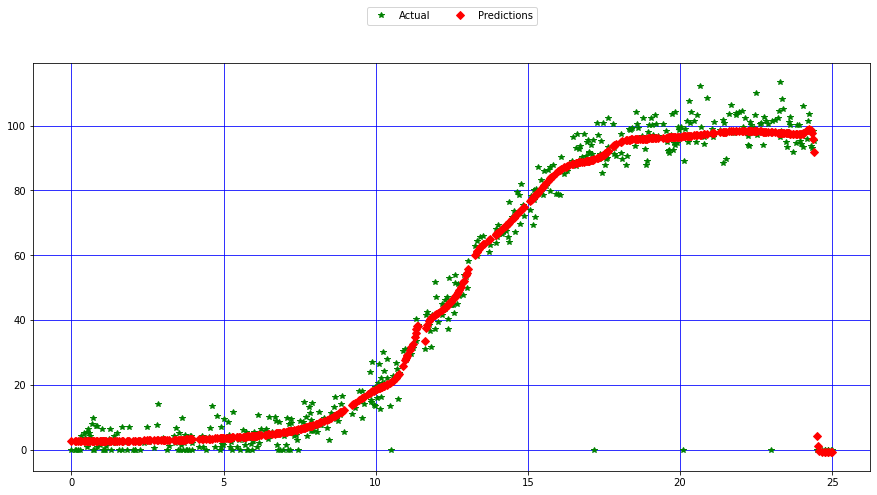

In [8]:
# Plot the values.
#sets the size of the graph
plt.figure(figsize=(15,7.5))
#adds a grid to the graph
plt.grid(color='b', linestyle='-')
#plots teh actual data from the dataset
plt.plot(myPPData['speed'],myPPData['power'], 'g*', label='Actual')
#plots the predicted data for the trained model
plt.plot(myPPData['speed'],model.predict(myPPData['speed']), 'rD', label='Predictions')
#plots the legend outside the graph
plt.legend(loc="upper center", bbox_to_anchor=(0.5, 1.15), ncol=2)
#displays a figure
plt.show()

Then I save the prediciton to be used by my webService.py function to calculate the predicted power when the user gives a wind speed.

In [7]:
#saves the prediciton data to be used by the web app
model.save('powerproduction.h5')

## References

[1][https://www.kite.com/python/answers/how-to-move-the-legend-outside-of-a-matplotlib-plot-in-python]  
[2][https://stackoverflow.com/questions/8209568/how-do-i-draw-a-grid-onto-a-plot-in-python]  
[3][https://www.shanelynn.ie/select-pandas-dataframe-rows-and-columns-using-iloc-loc-and-ix/]  
[4][https://keras.io/api/layers/core_layers/input/]  
[5][https://www.tutorialspoint.com/keras/keras_layers.htm]  
[6][https://keras.io/api/models/model/]  
[7][https://www.tensorflow.org/guide/keras/save_and_serialize]  
[8][https://keras.io/api/layers/core_layers/dense/]  
[9][https://www.tutorialspoint.com/keras/keras_dense_layer.htm]
[10][https://stackoverflow.com/questions/56325408/input-shape-not-recognised-in-keras-model]
[11][https://stackoverflow.com/questions/56311638/how-how-iloc-1-works-can-any-one-explain-1-params]
[12][https://matplotlib.org/3.1.1/api/_as_gen/matplotlib.pyplot.show.html]


# End